In [191]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression, LogisticRegression, Ridge
from sklearn.model_selection import GridSearchCV, train_test_split
import seaborn as sns
from scipy.stats import kurtosis
from sklearn.linear_model import QuantileRegressor
from scipy.stats import spearmanr
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import make_scorer
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error
from lightgbm import LGBMRegressor


## 1. Data

Nous avons utilisé le dataset disponible dans le DataChallenge 2023 proposé par QRT concernant la prédiction de l'évolution du prix de l'émectricité.

### 1.1. Analyse de la temporalité

In [192]:
X = pd.read_csv('../data/X_train.csv')
y= pd.read_csv('../data/y_train.csv')


In [193]:
n_samples, n_features = X.shape
print('Les données contiennent : {} échantillons de dimension {}'.format(n_samples, n_features))

Les données contiennent : 1494 échantillons de dimension 35


### 1.2. Description des données

In [194]:
with pd.option_context('display.max_columns', None):
    display(X.head())
    display(y.head())

,ID,DAY_ID,COUNTRY,DE_CONSUMPTION,FR_CONSUMPTION,DE_FR_EXCHANGE,FR_DE_EXCHANGE,DE_NET_EXPORT,FR_NET_EXPORT,DE_NET_IMPORT,FR_NET_IMPORT,DE_GAS,FR_GAS,DE_COAL,FR_COAL,DE_HYDRO,FR_HYDRO,DE_NUCLEAR,FR_NUCLEAR,DE_SOLAR,FR_SOLAR,DE_WINDPOW,FR_WINDPOW,DE_LIGNITE,DE_RESIDUAL_LOAD,FR_RESIDUAL_LOAD,DE_RAIN,FR_RAIN,DE_WIND,FR_WIND,DE_TEMP,FR_TEMP,GAS_RET,COAL_RET,CARBON_RET
0,1054,206,FR,0.210099,-0.427458,-0.606523,0.606523,NaN,0.692860,NaN,-0.692860,0.441238,-0.213766,0.740627,0.288782,2.209047,0.207838,0.709614,-0.190463,0.101766,1.248911,-0.573370,-0.269460,0.870344,0.626666,-0.444661,-0.172680,-0.556356,-0.790823,-0.283160,-1.069070,-0.063404,0.339041,0.124552,-0.002445
1,2049,501,FR,-0.022399,-1.003452,-0.022063,0.022063,-0.573520,-1.130838,0.573520,1.130838,0.174773,0.426940,-0.170392,-0.762153,0.187964,-0.807112,-1.882740,-2.185961,1.987428,3.237380,-0.035514,-0.107350,-0.194308,-0.395469,-1.183194,-1.240300,-0.770457,1.522331,0.828412,0.437419,1.831241,-0.659091,0.047114,-0.490365
2,1924,687,FR,1.395035,1.978665,1.021305,-1.021305,-0.622021,-1.682587,0.622021,1.682587,2.351913,2.122241,1.572267,0.777053,-0.108578,0.779142,-1.897109,0.735137,-1.115583,-0.371039,-0.298755,-0.141239,0.428272,1.336625,1.947273,-0.480700,-0.313338,0.431134,0.487608,0.684884,0.114836,0.535974,0.743338,0.204952
3,297,720,DE,-0.983324,-0.849198,-0.839586,0.839586,-0.270870,0.563230,0.270870,-0.563230,0.487818,0.194659,-1.473817,-0.786025,-0.368417,1.320483,-0.205547,-1.589554,1.751523,0.562944,-0.010090,0.366885,-2.330557,-1.191889,-0.976974,-1.114838,-0.507570,-0.499409,-0.236249,0.350938,-0.417514,0.911652,-0.296168,1.073948
4,1101,818,FR,0.143807,-0.617038,-0.924990,0.924990,NaN,0.990324,NaN,-0.990324,0.238693,-0.240862,1.003734,-0.274975,-0.230179,-0.795983,-0.005581,0.176935,0.693543,0.723587,-0.774941,-0.564498,0.691040,0.571613,-0.526267,-0.541465,-0.424550,-1.088158,-1.011560,0.614338,0.729495,0.245109,1.526606,2.614378


,ID,TARGET
0,1054,0.028313
1,2049,-0.112516
2,1924,-0.180840
3,297,-0.260356
4,1101,-0.071733


Les données d'entrée possèdent 35 colonnes :

- ID : Identifiant d'indexe unique, associé à un jour (DAY_ID) et un pays (COUNTRY),
- DAY_ID : Identifiant du jour - les dates ont été annonymisées en préservant la structure des données,
- COUNTRY : Identifiant du pays - DE = Allemagne, FR = France, 

et composées ensuite de variations journalières du prix de matières premières,

- GAS_RET : Gaz en Europe,
- COAL_RET : Charbon en Europe,
- CARBON_RET : Futures sur les emissions carbone, 

de mesures météorologiques (journalières, dans le pays x),

- x_TEMP : Temperature,
- x_RAIN : Pluie,
- x_WIND : Vent,

de mesures de productions d'energie (journalière, dans le pays x),

- x_GAS : Gaz naturel,
- x_COAL : Charbon,
- x_HYDRO : Hydrolique,
- x_NUCLEAR : Nucléaire,
- x_SOLAR : Photovoltaïque,
- x_WINDPOW : Eolienne,
- x_LIGNITE : Lignite,

et de mesures d'utilisation électrique (journalières, dans le pays x),

- x_CONSUMPTON : Electricité totale consommée,
- x_RESIDUAL_LOAD : Electricité consommée après utilisation des énergies renouvelables,
- x_NET_IMPORT: Electricité importée depuis l'Europe,
- x_NET_EXPORT: Electricité exportée vers l'Europe,
- DE_FR_EXCHANGE: Electricité échangée entre Allemagne et France,
- FR_DE_EXCHANGE: Electricité échangée entre France et Allemagne.



#### Commentaires:
- Dans le dataset, les variation des prix allemands et français sont mélangées. Vaut-il mieux les traiter séparamment ?
- Dans un premier temps nous allons essayer de contruire un unique modèle de prédiction qualitatif.

In [195]:
X["DAY_ID"].value_counts().head(1000)

DAY_ID
77      2
237     2
231     2
1001    2
1070    2
       ..
0       1
308     1
721     1
969     1
90      1
Name: count, Length: 851, dtype: int64

In [196]:
day_ids = [77, 237, 231, 1001, 1070, 1112, 908, 757, 542, 391]

X[X["DAY_ID"].isin(day_ids)].sort_values("DAY_ID")


,ID,DAY_ID,COUNTRY,DE_CONSUMPTION,FR_CONSUMPTION,DE_FR_EXCHANGE,FR_DE_EXCHANGE,DE_NET_EXPORT,FR_NET_EXPORT,DE_NET_IMPORT,...,FR_RESIDUAL_LOAD,DE_RAIN,FR_RAIN,DE_WIND,FR_WIND,DE_TEMP,FR_TEMP,GAS_RET,COAL_RET,CARBON_RET
492,1278,77,FR,0.204839,-0.556874,-0.868887,0.868887,-0.923998,0.858085,0.923998,...,-0.606544,-1.316356,-0.173395,-0.419634,-0.195610,-1.597233,-0.701258,-1.394954,-0.403791,-0.316186
852,62,77,DE,0.204839,-0.556874,-0.868887,0.868887,-0.923998,0.858085,0.923998,...,-0.606544,-1.316356,-0.173395,-0.419634,-0.195610,-1.597233,-0.701258,-1.394954,-0.403791,-0.316186
550,2060,231,FR,-0.511138,-0.802438,0.938683,-0.938683,-0.723702,-2.174215,0.723702,...,-0.779227,-1.516457,-0.478945,0.909630,0.100861,0.171330,0.453644,-0.664758,-0.189012,-0.667172
1212,844,231,DE,-0.511138,-0.802438,0.938683,-0.938683,-0.723702,-2.174215,0.723702,...,-0.779227,-1.516457,-0.478945,0.909630,0.100861,0.171330,0.453644,-0.664758,-0.189012,-0.667172
561,1363,237,FR,0.664205,0.326647,-0.213652,0.213652,-0.027239,-0.462336,0.027239,...,0.349165,0.045906,-0.739773,-0.849181,-0.669926,-0.193674,-0.369820,0.444776,-0.193880,0.318229
567,147,237,DE,0.664205,0.326647,-0.213652,0.213652,-0.027239,-0.462336,0.027239,...,0.349165,0.045906,-0.739773,-0.849181,-0.669926,-0.193674,-0.369820,0.444776,-0.193880,0.318229
560,2050,391,FR,-0.305770,-0.818128,0.397849,-0.397849,-0.299681,-1.494674,0.299681,...,-0.997108,-0.450657,-0.108242,1.390915,1.370472,-0.380167,0.859136,-1.033335,0.604034,-1.409869
1364,834,391,DE,-0.305770,-0.818128,0.397849,-0.397849,-0.299681,-1.494674,0.299681,...,-0.997108,-0.450657,-0.108242,1.390915,1.370472,-0.380167,0.859136,-1.033335,0.604034,-1.409869
559,646,542,DE,1.166555,-0.318736,-0.243236,0.243236,0.976377,0.877926,-0.976377,...,-1.091336,-0.420718,-0.471684,2.543151,3.499060,1.297569,1.306755,-0.371456,2.309202,0.717430
960,1862,542,FR,1.166555,-0.318736,-0.243236,0.243236,0.976377,0.877926,-0.976377,...,-1.091336,-0.420718,-0.471684,2.543151,3.499060,1.297569,1.306755,-0.371456,2.309202,0.717430


In [197]:
y.loc[[1278, 62]]

,ID,TARGET
1278,878,-0.444789
62,1560,-0.532471


#### Commentaires 
- On observe que les features de certaines dates sont utilisés deux fois dans le dataset : une fois pour décrire la Variation du prix de l'électricté en France, et l'autre fois pour décrire celle en Allemagne
- On observe aussi que les même feautures  ont des impacts totalement différents sur la variation du prix de l'éléctricité en Allemagne ou en France. Il serait donc judicieux de bien préparer le set de données avant de passer à la modélisation.

### 1.3. Les valeurs manquantes
- Pour les données numériques, nous souhaitons remplacer les données manquantes par une interpolation polynomiale.
- De plus nous allon rendre la colonne "COUNTRY" binaire.

In [198]:
with pd.option_context('display.max_columns', None):
    display(X.isna().sum())

ID                    0
DAY_ID                0
COUNTRY               0
DE_CONSUMPTION        0
FR_CONSUMPTION        0
DE_FR_EXCHANGE       25
FR_DE_EXCHANGE       25
DE_NET_EXPORT       124
FR_NET_EXPORT        70
DE_NET_IMPORT       124
FR_NET_IMPORT        70
DE_GAS                0
FR_GAS                0
DE_COAL               0
FR_COAL               0
DE_HYDRO              0
FR_HYDRO              0
DE_NUCLEAR            0
FR_NUCLEAR            0
DE_SOLAR              0
FR_SOLAR              0
DE_WINDPOW            0
FR_WINDPOW            0
DE_LIGNITE            0
DE_RESIDUAL_LOAD      0
FR_RESIDUAL_LOAD      0
DE_RAIN              94
FR_RAIN              94
DE_WIND              94
FR_WIND              94
DE_TEMP              94
FR_TEMP              94
GAS_RET               0
COAL_RET              0
CARBON_RET            0
dtype: int64

In [199]:
numeric_features = ['GAS_RET',
                     'COAL_RET', 
                     'CARBON_RET',
                     'DE_TEMP',
                     'DE_RAIN',
                     'DE_WIND',
                     'DE_GAS',
                     'DE_COAL',
                     'DE_HYDRO',
                     'DE_NUCLEAR',
                     'DE_SOLAR',
                     'DE_WINDPOW',
                     'DE_LIGNITE',
                     'DE_CONSUMPTION',
                     'DE_RESIDUAL_LOAD',
                     'DE_NET_IMPORT',
                     'DE_NET_EXPORT',
                     'FR_TEMP',
                     'FR_RAIN',
                     'FR_WIND',
                     'FR_GAS',
                     'FR_COAL',
                     'FR_HYDRO',
                     'FR_NUCLEAR',
                     'FR_SOLAR',
                     'FR_WINDPOW',
                     'FR_CONSUMPTION',
                     'FR_RESIDUAL_LOAD',
                     'FR_NET_IMPORT',
                     'FR_NET_EXPORT',
                     'DE_FR_EXCHANGE',
                     'FR_DE_EXCHANGE']
categorical_features = ['COUNTRY']

In [200]:
X_DE = X[X['COUNTRY'] == 'DE']
X_FR = X[X['COUNTRY'] == 'FR']

print(f"Le dataset allemand comporte {len(X_DE)} échantillons.")
print(f"Le dataset français comporte {len(X_FR)} échantillons.")

Le dataset allemand comporte 643 échantillons.
Le dataset français comporte 851 échantillons.


In [201]:
X[numeric_features].interpolate(method='polynomial',order=3, inplace=True)
X[numeric_features] = X[numeric_features].fillna(0)

X["COUNTRY"] = (X["COUNTRY"] == "FR").astype(int) # FR=1, DE=0

/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/194734390.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[numeric_features].interpolate(method='polynomial',order=3, inplace=True)


In [202]:
X.isna().sum()

ID                  0
DAY_ID              0
COUNTRY             0
DE_CONSUMPTION      0
FR_CONSUMPTION      0
DE_FR_EXCHANGE      0
FR_DE_EXCHANGE      0
DE_NET_EXPORT       0
FR_NET_EXPORT       0
DE_NET_IMPORT       0
FR_NET_IMPORT       0
DE_GAS              0
FR_GAS              0
DE_COAL             0
FR_COAL             0
DE_HYDRO            0
FR_HYDRO            0
DE_NUCLEAR          0
FR_NUCLEAR          0
DE_SOLAR            0
FR_SOLAR            0
DE_WINDPOW          0
FR_WINDPOW          0
DE_LIGNITE          0
DE_RESIDUAL_LOAD    0
FR_RESIDUAL_LOAD    0
DE_RAIN             0
FR_RAIN             0
DE_WIND             0
FR_WIND             0
DE_TEMP             0
FR_TEMP             0
GAS_RET             0
COAL_RET            0
CARBON_RET          0
dtype: int64

#### Commentaires:
- Nous n'avons plus aucune donnée manquante.

### 1.4. Valeurs Extrêmes

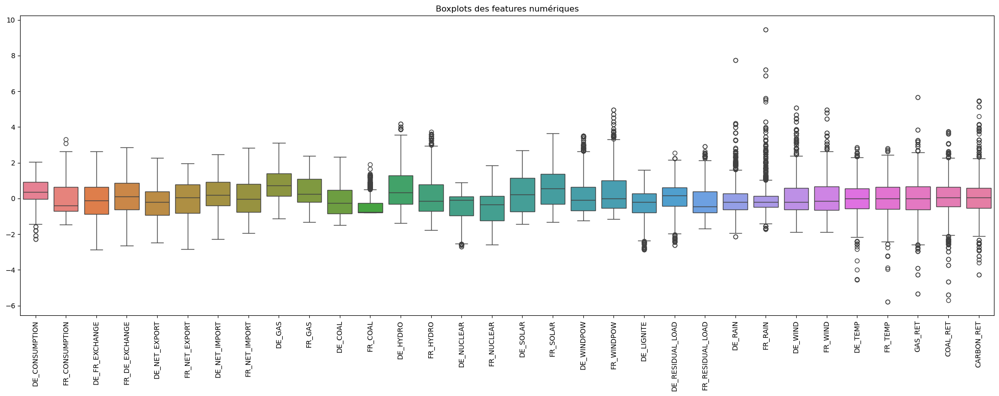

In [203]:
numeric_cols = X.drop(columns=categorical_features + ['ID', 'DAY_ID','TARGET'], errors='ignore')

plt.figure(figsize=(20, 8))
sns.boxplot(data=numeric_cols)
plt.xticks(rotation=90)
plt.title('Boxplots des features numériques')
plt.tight_layout()
plt.show()


#### Commentaires:
- Bien que plusieurs variables présentent des valeurs extrêmes, on ne les supprime pas. En effet, ces valeurs correspondent à des événements économiques et météorologiques réels (pics de prix de l’énergie, stress du réseau, conditions météorologiques exceptionnelles) et font partie intégrante du phénomène étudié. Les méthodes de détection d’outliers basées sur des hypothèses de normalité (telles que le Z-score) n’ont donc pas été retenues, afin d’éviter un biais d’échantillonnage et une perte d’information économiquement pertinente. (cf papier Day-Ahead electricity price forecasting)

### 1.5. Ingénerie des données

Les jours vont de 0 à 1215 on ne peut pas faire grand chose. Nous pouvons néanmoins créer des Time Block.

In [204]:
X["time_block"] = pd.qcut(X["DAY_ID"], q=4, labels=False)

Les  variations journalières brutes des matières premières sont tres bruités. Selon le papier (Weron (2014) – Electricity price forecasting), il est recommandé de calculer une moyenne mobile. Nous allons caluler des moyenne mobiles sur 7, 14 et 30 jours.

In [205]:
X_DE = X[X['COUNTRY'] == 0]
X_FR = X[X['COUNTRY'] == 1]

X_DE = X_DE.sort_values("DAY_ID")
X_FR = X_FR.sort_values("DAY_ID")

def rolling_mean_features(df, target_col, window_sizes):
    for window_size in window_sizes:
        for col in target_cols:
            df[col + "_MA_" + str(window_size)] = df[col].rolling(window=window_size, min_periods=1).mean()
    return df

window_sizes = [7, 14, 30]
target_cols = ['GAS_RET', 'COAL_RET', 'CARBON_RET']
X_DE = rolling_mean_features(X_DE, target_cols, window_sizes)
X_FR = rolling_mean_features(X_FR, target_cols, window_sizes)

X = pd.concat([X_DE, X_FR])

In [206]:
display(X.head())
display(X.tail())

,ID,DAY_ID,COUNTRY,DE_CONSUMPTION,FR_CONSUMPTION,DE_FR_EXCHANGE,FR_DE_EXCHANGE,DE_NET_EXPORT,FR_NET_EXPORT,DE_NET_IMPORT,...,time_block,GAS_RET_MA_7,COAL_RET_MA_7,CARBON_RET_MA_7,GAS_RET_MA_14,COAL_RET_MA_14,CARBON_RET_MA_14,GAS_RET_MA_30,COAL_RET_MA_30,CARBON_RET_MA_30
1468,111,2,0,-0.068972,-0.667390,-1.102015,1.102015,-1.080403,0.256736,1.080403,...,0,1.802550,1.140920,0.900434,1.802550,1.140920,0.900434,1.802550,1.140920,0.900434
680,800,3,0,-0.134670,-0.834564,-1.051716,1.051716,-1.881881,-0.612133,1.881881,...,0,1.121336,0.538185,0.433839,1.121336,0.538185,0.433839,1.121336,0.538185,0.433839
991,831,5,0,-0.297850,-0.470371,0.144615,-0.144615,-1.208286,-1.811403,1.208286,...,0,0.708232,0.542268,0.549849,0.708232,0.542268,0.549849,0.708232,0.542268,0.549849
1356,779,7,0,0.057599,-0.625625,0.002239,-0.002239,-0.676226,-0.745182,0.676226,...,0,0.436179,0.536315,0.403727,0.436179,0.536315,0.403727,0.436179,0.536315,0.403727
713,841,8,0,-0.282744,-0.700027,1.309253,-1.309253,0.248085,-2.226840,-0.248085,...,0,0.660408,0.458379,0.788966,0.660408,0.458379,0.788966,0.660408,0.458379,0.788966


,ID,DAY_ID,COUNTRY,DE_CONSUMPTION,FR_CONSUMPTION,DE_FR_EXCHANGE,FR_DE_EXCHANGE,DE_NET_EXPORT,FR_NET_EXPORT,DE_NET_IMPORT,...,time_block,GAS_RET_MA_7,COAL_RET_MA_7,CARBON_RET_MA_7,GAS_RET_MA_14,COAL_RET_MA_14,CARBON_RET_MA_14,GAS_RET_MA_30,COAL_RET_MA_30,CARBON_RET_MA_30
479,2039,1208,1,0.046568,-0.709011,0.427976,-0.427976,-0.578391,-1.678101,0.578391,...,3,-0.046914,0.469676,-0.092219,0.227972,0.381702,0.150943,0.308468,0.270032,0.109541
1451,972,1209,1,1.109804,1.301061,1.565552,-1.565552,0.000000,0.000000,0.000000,...,3,-0.118148,0.773734,-0.022019,0.085437,0.417091,0.160228,0.260587,0.250637,0.106696
1007,1987,1212,1,-0.046100,-0.520506,-0.270515,0.270515,-0.137917,-0.789824,0.137917,...,3,-0.167486,0.631489,-0.017537,0.107693,0.488877,0.218320,0.265039,0.253150,0.101696
873,1688,1213,1,1.407027,1.313254,-0.456126,0.456126,0.333142,-0.069222,-0.333142,...,3,-0.208687,0.504285,-0.059291,-0.014171,0.334586,0.105739,0.282441,0.192597,0.099015
1437,1049,1215,1,0.544810,-0.378158,-0.065993,0.065993,0.000000,0.257829,0.000000,...,3,0.099937,0.596258,0.196266,0.083504,0.472455,0.117372,0.316327,0.183073,0.225795


In [207]:
X_DE = X[X['COUNTRY'] == 0].sort_values("DAY_ID")
X_FR = X[X['COUNTRY'] == 1].sort_values("DAY_ID")

# Création de la variable décalée
X_DE["PREVIOUS_Y"] = y.loc[X_DE.index, "TARGET"].shift(1)
X_FR["PREVIOUS_Y"] = y.loc[X_FR.index, "TARGET"].shift(1)

# Fusion des deux datasets
X_combined = pd.concat([X_DE, X_FR])

# Suppression des lignes contenant les NaN (les premières lignes de chaque pays)
X = X_combined.dropna(subset=["PREVIOUS_Y"])

# Alignement de y avec les indices de X après suppression des NaN
y = y.loc[X.index]

Les interactions entre la météo et la production sont trèss influentes sur le prix de l'éléctrcité. Par exemplen, un jour très venteux avec beaucoup d’éolien=prix plus bas, mais un jour venteux avec peu d’éolien = effet faible (Ziel & Weron (2018), Gianfreda et al. (2016)).

In [208]:
# interactions vent × éolien
X["DE_WIND_WINDPOW"] = X["DE_WIND"] * X["DE_WINDPOW"]
X["FR_WIND_WINDPOW"] = X["FR_WIND"] * X["FR_WINDPOW"]

# température × residual load
X["DE_TEMP_RESLOAD"] = X["DE_TEMP"] * X["DE_RESIDUAL_LOAD"]

X["FR_TEMP_RESLOAD"] = X["FR_TEMP"] * X["FR_RESIDUAL_LOAD"]

# pluie × hydro
X["DE_RAIN_HYDRO"] = X["DE_RAIN"] * X["DE_HYDRO"]

X["FR_RAIN_HYDRO"] = X["FR_RAIN"] * X["FR_HYDRO"]

/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/3135943314.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X["DE_WIND_WINDPOW"] = X["DE_WIND"] * X["DE_WINDPOW"]
/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/3135943314.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X["FR_WIND_WINDPOW"] = X["FR_WIND"] * X["FR_WINDPOW"]
/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/3135943314.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of 

De même, selon la littérature, l'intéraction entre les exportations/importations et le residual load est important. Plus le residual load est élevé, plus le système est sous tension. EN effet, un residual load elevé accompagné d'un import net élevé signifie que le pays n'arrive pas à produire suffisament. Ainsi le sprix explosent.

In [209]:
X["LOAD_IMPORT_FR"]=X["FR_RESIDUAL_LOAD"] * X['FR_NET_IMPORT']
X["LOAD_IMPORT_DE"]=X["DE_RESIDUAL_LOAD"] * X['DE_NET_IMPORT']

/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/1890040429.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X["LOAD_IMPORT_FR"]=X["FR_RESIDUAL_LOAD"] * X['FR_NET_IMPORT']
/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/1890040429.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X["LOAD_IMPORT_DE"]=X["DE_RESIDUAL_LOAD"] * X['DE_NET_IMPORT']


Nous allons également créer des variables surpplémentaires pour différencier les énergies renouvlables et non renouvlables.

In [210]:

X['DE_NON_RENEWABLE'] = X['DE_GAS'] + X['DE_COAL'] + X['DE_LIGNITE'] + X['DE_NUCLEAR']
X['DE_RENEWABLE'] = X['DE_HYDRO'] + X['DE_SOLAR'] + X['DE_WINDPOW']
X['DE_EXCESS_ENERGY'] = X['DE_NON_RENEWABLE'] + X['DE_RENEWABLE'] - X['DE_CONSUMPTION']

X['FR_NON_RENEWABLE'] = X['FR_GAS'] + X['FR_COAL'] + X['FR_NUCLEAR']
X['FR_RENEWABLE'] = X['FR_HYDRO'] + X['FR_SOLAR'] + X['FR_WINDPOW']
X['FR_EXCESS_ENERGY'] = X['FR_NON_RENEWABLE'] + X['FR_RENEWABLE'] - X['FR_CONSUMPTION']

/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/1056832754.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['DE_NON_RENEWABLE'] = X['DE_GAS'] + X['DE_COAL'] + X['DE_LIGNITE'] + X['DE_NUCLEAR']
/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/1056832754.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['DE_RENEWABLE'] = X['DE_HYDRO'] + X['DE_SOLAR'] + X['DE_WINDPOW']
/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/1056832754.py:3: SettingWithCopyWarn

Enfin, nous allons ajouter des variables plus précises sur les consommations allemandes et françaises.

In [211]:
  # 2. RATIOS - Comparaisons DE / FR
X['CONSUMPTION_RATIO'] = X['DE_CONSUMPTION'] / (X['FR_CONSUMPTION'] + 1e-6)
X['RESIDUAL_LOAD_RATIO'] = X['DE_RESIDUAL_LOAD'] / (X['FR_RESIDUAL_LOAD'] + 1e-6)

# 4. STRESS INDICATORS - Indicateurs de tension du réseau
X['DE_LOAD_STRESS'] = X['DE_RESIDUAL_LOAD'] / (X['DE_CONSUMPTION'] + 1e-6)
X['FR_LOAD_STRESS'] = X['FR_RESIDUAL_LOAD'] / (X['FR_CONSUMPTION'] + 1e-6)

/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/3023231490.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['CONSUMPTION_RATIO'] = X['DE_CONSUMPTION'] / (X['FR_CONSUMPTION'] + 1e-6)
/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/3023231490.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['RESIDUAL_LOAD_RATIO'] = X['DE_RESIDUAL_LOAD'] / (X['FR_RESIDUAL_LOAD'] + 1e-6)
/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/3023231490.py:6: SettingWithCopyW

### 1.7. La multicolinéarité

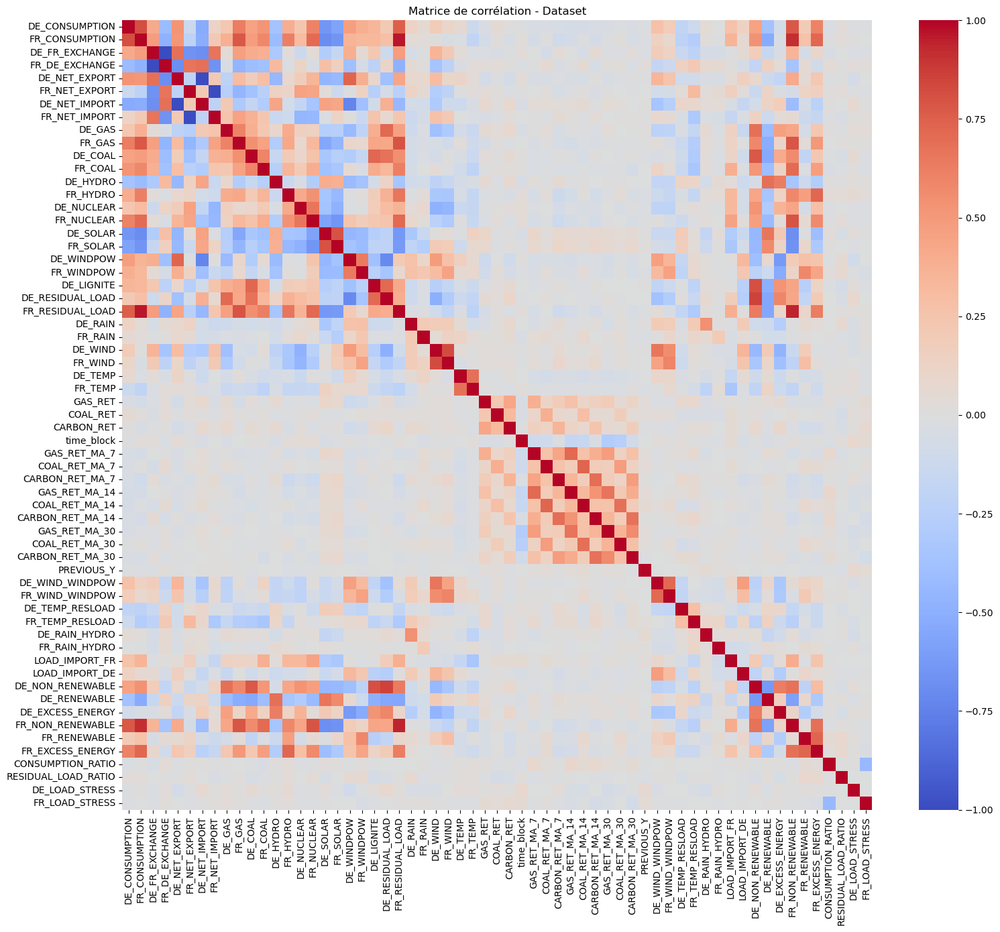

In [212]:
plt.figure(figsize=(16, 14))
numeric_cols = X.drop(columns=categorical_features + ['ID', 'DAY_ID'], errors='ignore')
sns.heatmap(numeric_cols.corr(), cmap="coolwarm", annot=False, fmt='.2f', cbar=True)
plt.title('Matrice de corrélation - Dataset')
plt.tight_layout()
plt.show()

In [213]:
# Trouver les colonnes à supprimer pour éviter la multicolinéarité
corr_matrix = numeric_cols.corr()
cols = corr_matrix.columns
cols_corr = []

for i in range(len(cols)):
    for j in range(i + 1, len(cols)):
        if abs(corr_matrix.iloc[i, j]) > 0.80:
            cols_corr.append((cols[i], cols[j]))

# Supprimer les doublons dans la liste
cols_corr = list(set(cols_corr))

print(f"Les features fortement corrélés sont (corrélation > 0.80):" )
display(cols_corr)

Les features fortement corrélés sont (corrélation > 0.80):


[('FR_RESIDUAL_LOAD', 'FR_NON_RENEWABLE'),
 ('DE_RESIDUAL_LOAD', 'DE_NON_RENEWABLE'),
 ('FR_CONSUMPTION', 'FR_RESIDUAL_LOAD'),
 ('FR_NET_EXPORT', 'FR_NET_IMPORT'),
 ('DE_NET_EXPORT', 'DE_NET_IMPORT'),
 ('DE_FR_EXCHANGE', 'FR_DE_EXCHANGE'),
 ('FR_CONSUMPTION', 'FR_NON_RENEWABLE'),
 ('DE_SOLAR', 'FR_SOLAR'),
 ('DE_LIGNITE', 'DE_NON_RENEWABLE'),
 ('DE_WIND', 'FR_WIND'),
 ('DE_CONSUMPTION', 'FR_CONSUMPTION')]

#### Commentaires : 
- Certains feautures sont fortement corrélés, nous allons donc en supprimer certaines variables de notre dataset pour éviter la multicolinéarité: "FR_RESIDUAL_LOAD", "DE_WIND", "DE_SOLAR", "FR_CONSUMPTION", "FR_NET_EXPORT", "DE_RESIDUAL_LOAD", "DE_CONSUMPTION", "DE_FR_EXCHANGE", "DE_LIGNITE", "DE_NET_EXPORT".

In [214]:
cols_to_remove = [
"FR_RESIDUAL_LOAD",
"DE_WIND",
"DE_SOLAR",
"FR_CONSUMPTION",
"FR_NET_EXPORT",
"DE_RESIDUAL_LOAD",
"DE_CONSUMPTION",
"DE_FR_EXCHANGE",
"DE_LIGNITE",
"DE_NET_EXPORT"
]

X = X.drop(cols_to_remove, axis=1)


### 1.8. Corélation entre Target et Features

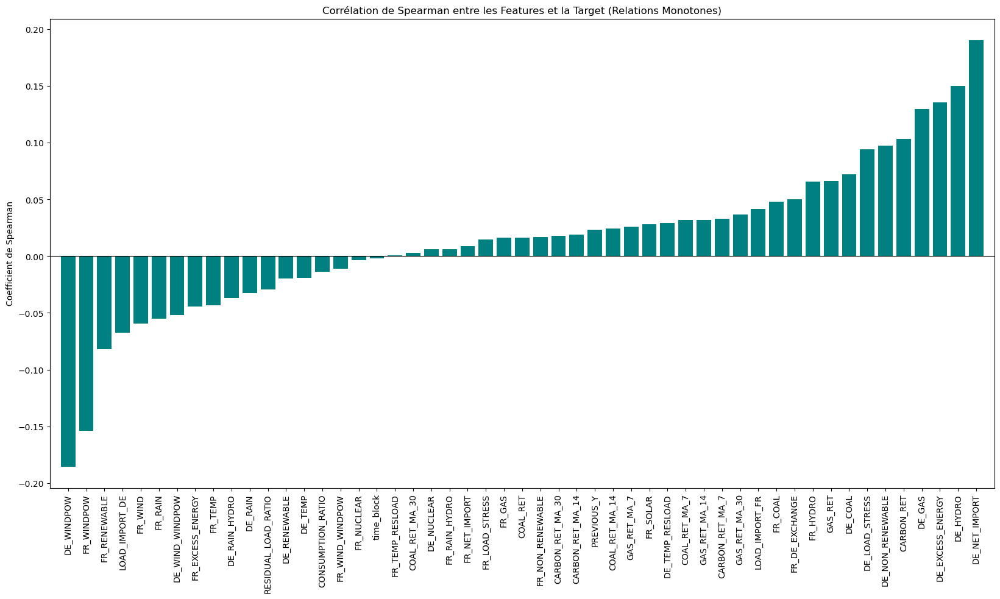

In [215]:
#Sélection des colonnes numériques
numeric_cols = X.drop(columns=categorical_features + ['ID', 'DAY_ID'], errors='ignore')

# Calcul de la corrélation de Spearman (méthode des rangs)
corr_matrix = numeric_cols.corrwith(y["TARGET"], method='spearman')

# Nettoyage et tri
corr_matrix = corr_matrix.dropna().sort_values()

# visualisation
plt.figure(figsize=(20, 10))
plt.title("Corrélation de Spearman entre les Features et la Target (Relations Monotones)")
plt.bar(range(len(corr_matrix)), corr_matrix, color="teal", align="center") # Couleur changée pour différencier
plt.xticks(range(len(corr_matrix)), corr_matrix.index, rotation='vertical')
plt.axhline(0, color='black', linewidth=0.8) # Ajout d'une ligne à 0 pour la clarté
plt.xlim([-1, len(corr_matrix)])
plt.ylabel("Coefficient de Spearman")
plt.show()

#### Commentaires:
- Plusieurs variables ne sont quasiment pas corrélées avec la variable target, nous décidons donc de les retirer

In [216]:
cols_to_remove_2 = corr_matrix[abs(corr_matrix) <0.03]
print("Variables avec |corrélation| < 0.03:")
display(cols_to_remove_2)

Variables avec |corrélation| < 0.03:


RESIDUAL_LOAD_RATIO   -0.029222
DE_RENEWABLE          -0.019629
DE_TEMP               -0.019303
CONSUMPTION_RATIO     -0.013761
FR_WIND_WINDPOW       -0.010988
FR_NUCLEAR            -0.003555
time_block            -0.002024
FR_TEMP_RESLOAD        0.000621
COAL_RET_MA_30         0.002626
DE_NUCLEAR             0.006110
FR_RAIN_HYDRO          0.006111
FR_NET_IMPORT          0.008701
FR_LOAD_STRESS         0.014936
FR_GAS                 0.016362
COAL_RET               0.016513
FR_NON_RENEWABLE       0.016753
CARBON_RET_MA_30       0.017976
CARBON_RET_MA_14       0.018791
PREVIOUS_Y             0.023156
COAL_RET_MA_14         0.024578
GAS_RET_MA_7           0.025952
FR_SOLAR               0.028249
DE_TEMP_RESLOAD        0.029210
dtype: float64

In [217]:
cols_to_remove_2 = [
    "FR_WIND_WINDPOW",
    "time_block",
    "FR_NUCLEAR",
    "FR_TEMP_RESLOAD",
    "COAL_RET_MA_30",
    "FR_RAIN_HYDRO",
    "DE_NUCLEAR",
    "FR_NET_IMPORT",
    "DE_TEMP",
    "DE_RENEWABLE",
    "CONSUMPTION_RATIO",
    "FR_LOAD_STRESS",
    "FR_GAS",
    "FR_NON_RENEWABLE",
    "COAL_RET",
    "CARBON_RET_MA_30",
    "CARBON_RET_MA_14",
    "COAL_RET_MA_14",
    "GAS_RET_MA_7",
    "FR_SOLAR",
    "DE_TEMP_RESLOAD"
]
X= X.drop(cols_to_remove_2, axis=1)

### 1.7. Séparation du Dataset : Entraînement et Validation 

La temporalité n'est pas respectée dans le dataset. Les données ne sont pas ordonnées par ordre chronologique. Il est donc nécessaire d'ordonner le datatset avant de le séparer en Entraîmenet/Validation pour éviter toute fuite de donnée.
Nous séparons donc le jeux de données, tout en respectant la chronologie au sein des données allemandes et françaises. L'objectif est de prédire le futur. On choisit un séparation 80% / 20%.

In [218]:
X = X.set_index("ID")
y = y.set_index("ID")

split_ratio = 0.8

X_tr_list, X_val_list = [], []
y_tr_list, y_val_list = [], []


#pour chaque pays 
for country_val in X["COUNTRY"].unique():
    X_c = X[X["COUNTRY"] == country_val].copy()
    #on recupere y correspondant (extraire la colonne TARGET pour avoir une Series)
    y_c = y.loc[X_c.index, "TARGET"].copy()

    # on s'assure d'un ordre temporel
    X_c = X_c.sort_values("DAY_ID")
    y_c = y_c.loc[X_c.index]

    # on split 
    days = np.sort(X_c["DAY_ID"].unique())
    cutoff_idx = int(len(days) * split_ratio)
    cutoff_day = days[cutoff_idx]

    train_mask = X_c["DAY_ID"] < cutoff_day
    val_mask   = X_c["DAY_ID"] >= cutoff_day

    X_tr_list.append(X_c[train_mask])
    X_val_list.append(X_c[val_mask])
    y_tr_list.append(y_c[train_mask])
    y_val_list.append(y_c[val_mask])

# on concatene les pays
X_tr = pd.concat(X_tr_list).sort_index()
X_val = pd.concat(X_val_list).sort_index()
y_tr = pd.concat(y_tr_list).sort_index()
y_val = pd.concat(y_val_list).sort_index()

### 1.8. Normalisation des données

On observe que les variables ont des échelles très différentes différentes et que certaines varibales contiennent des valeurs extrêmes, il est donc nécessaire de standariser les données. On fit le scaler sur X_tr uniquement, puis on l'applique de manière équivalente à X_tr et X_val.


In [219]:
no_scale = ["COUNTRY"]
numeric_cols = [c for c in X_tr.columns if c not in no_scale]
# on fit le scaler sur train
scaler = StandardScaler()
scaler.fit(X_tr[numeric_cols])
# on transforme train et val
X_tr[numeric_cols] = scaler.transform(X_tr[numeric_cols])
X_val[numeric_cols] = scaler.transform(X_val[numeric_cols])

### 1.9. Choix de la métrique d'évaluation

In [220]:
y_tr.describe()

count    1193.000000
mean        0.109175
std         1.061758
min        -6.519268
25%        -0.208922
50%         0.000000
75%         0.247735
max         7.786578
Name: TARGET, dtype: float64

In [221]:
print(kurtosis(y_tr, fisher=True, bias=False))


13.675258070116335


L'objectif de du data challenge est donné : c'est de capter corrrectement l'intensité relative et le sens des mouvements des futurs de l'electrcité. De ce fait c'est spearman qui a été choisit pour 'l'evaluation. 

Cependant la question se pose de choisir la metrique pour la loss function. Nos données target sont caracterisées par : 
- des outliers très extrêmes, donc une queue longue
- une distribution relativement symétrique avec une médiane proche de 0
- des données typique entre -1 et 1 mais avec des extrêmes 
- une queue très épaisse, ce qui signifie que les valeurs extrêmes sont fréquentes. 

Puisque la validation repose sur le classement correct des variations, notre objectif n’est pas de prédire précisément l’amplitude des valeurs extrêmes, mais d’obtenir un classement cohérent des observations. On cherche donc à bien prédire l’ensemble de la distribution plutôt qu’à sur-pondérer quelques observations extrêmes. La RMSE, en pénalisant quadratiquement les erreurs, conduit le modèle à se concentrer excessivement sur les observations extrêmes, au détriment de la qualité globale du classement. Dans un contexte où l’objectif principal est ordinal, la MAE constitue une fonction de perte plus adaptée car elle répartit équitablement l’erreur sur l’ensemble des observations.

La métrique d’évaluation du challenge étant la corrélation de Spearman, notre objectif n’est pas de minimiser une erreur en niveau mais de préserver l’ordre relatif des variations journalières de prix.
Nous entraînons donc le modèle avec une loss MAE, plus robuste aux outliers fréquents sur les marchés de l’électricité, et nous évaluons la performance via Spearman, qui mesure la qualité de l’ordre prédit. Cette dissociation est classique en finance lorsque la métrique métier est une mesure de rang

## 2. Modèles

### 2.1. Modèle - Régression linéaire

Nous commençons par une regression lineaire, en utilisant la MAE.

In [222]:
mae = QuantileRegressor(
    quantile=0.5,   # MAE = médiane
    alpha=0.0  # pas de régularisation
)

mae.fit(X_tr, y_tr)
y_tr_pred_LR  = mae.predict(X_tr)
y_val_pred_LR = mae.predict(X_val)
spearman_train_LR = spearmanr(y_tr, y_tr_pred_LR).correlation
spearman_val_LR = spearmanr(y_val, y_val_pred_LR).correlation
mae_val_LR = mean_absolute_error(y_val, y_val_pred_LR)

print("Modèle de Régression Linéaire + MAE")
print(f"Spearman Train Model: {spearman_train_LR:.4f}")
print(f"Spearman Val Model: {spearman_val_LR:.4f}")
print(f"MAE Val Model: {mae_val_LR:.4f}")

Modèle de Régression Linéaire + MAE
Spearman Train Model: 0.2981
Spearman Val Model: 0.2226
MAE Val Model: 0.5534


#### Commentaire:
- Le score de Spearman est plus élevé sur le Train set que dans le Validation set, ce qui signifie sûrement qu'il y a un overfitting.

Nous nous intéressons à l'importance des features dans le modèle. Nous regardons donc les 15 features ayant les coefficient les plus élevés dans le modèle.

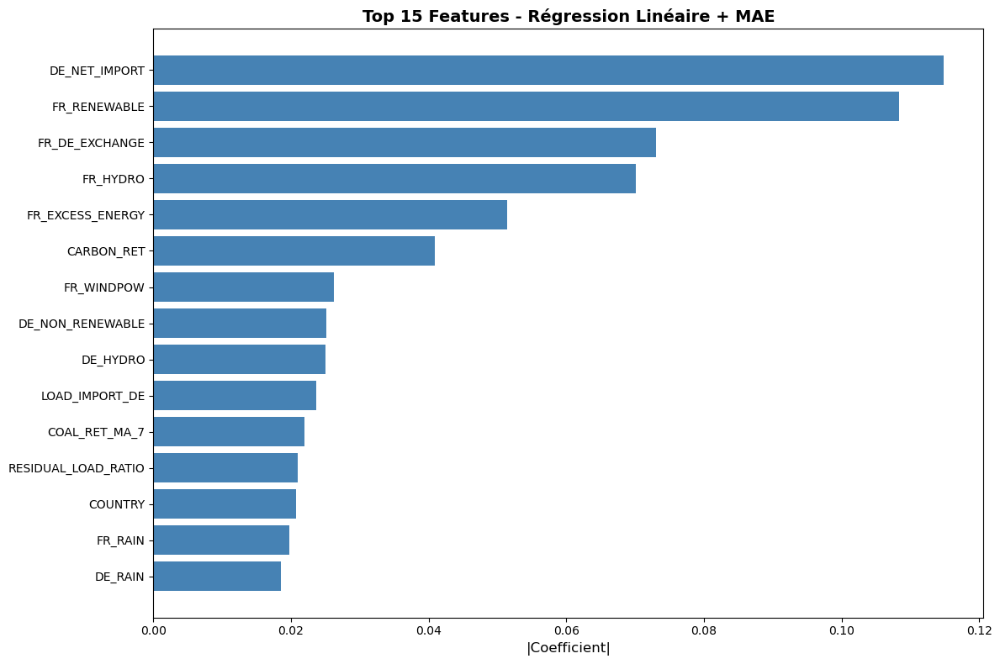

In [224]:
ols_coefs = pd.Series(mae.coef_, index=X_tr.columns).abs().sort_values(ascending=False)

top_15_ols = ols_coefs.head(15).sort_values()
plt.figure(figsize=(12, 8))
plt.barh(range(15), top_15_ols.values, color='steelblue')
plt.yticks(range(15), top_15_ols.index)
plt.xlabel('|Coefficient|', fontsize=12)
plt.title('Top 15 Features - Régression Linéaire + MAE', fontsize=14, fontweight='bold')

plt.tight_layout()
plt.show()

## 2. Modèle - Lasso

Au vu des résultats obtenus avec une simple regression linéiare + MAE, nous souhaites ajouter une pénalisation L1 pour limiter l'Overfitting. Pour cela nous utilissons un modèle Lasso + MAE. 

![alt text](image-1.png)

In [233]:
# on définit un score spearman
def spearman_scorer(y_true, y_pred):
    return spearmanr(y_true, y_pred).correlation

spearman_score = make_scorer(
    spearman_scorer,
    greater_is_better=True
)

# paramètres
alphas = np.logspace(-4, 1, 20)

model = QuantileRegressor(
    quantile=0.5,      # MAE
    solver="highs"
)

grid_search = GridSearchCV(
    estimator=model,
    param_grid={"alpha": alphas},
    scoring=spearman_score,
    n_jobs=-1
)

grid_search.fit(X_tr, y_tr)
best_LASSO = grid_search.best_estimator_

y_pred_tr_LASSO = best_LASSO.predict(X_tr)
y_val_pred_LASSO = best_LASSO.predict(X_val)


spearman_train_LASSO = spearmanr(y_tr, y_pred_tr_LASSO).correlation
spearman_val_LASSO = spearmanr(y_val, y_val_pred_LASSO).correlation
mae_val_LASSO = mean_absolute_error(y_val, y_val_pred_LASSO)


print("Modèle LASSO + MAE")
print("Meilleur alpha :", grid_search.best_params_["alpha"])
print("Spearman Train Model:", spearman_train_LASSO)
print("Spearman Val Model:", spearman_val_LASSO)
print(f"MAE Val Model: {mae_val_LASSO:.4f}")

/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/1315518208.py:3: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/1315518208.py:3: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/1315518208.py:3: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/1315518208.py:3: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/1315518208.py:3: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/kz/jrt48myn5lv2h550w8pl7qvm0000gn/T/ipykernel_84287/1315518208.py:3: ConstantInputWarning: An input array i

Modèle LASSO + MAE
Meilleur alpha : 0.0011288378916846883
Spearman Train Model: 0.29725947308978845
Spearman Val Model: 0.22549392830688422
MAE Val Model: 0.5528


#### Commentaires:
- Les résultats obtenus sont meilleurs que ceux obtenus avec les régression linéaire. D'une part notre score Spearman obtenu sur le Salidation set est meilleur. D'autre part, l'écart entre les scores de Spearman sur Train et Validation sets est nettement plus faible.
- Le modèle est donc plus fiable que le premier.

In [234]:
lasso_coefs = pd.Series(best_LASSO.coef_, index=X_tr.columns)
non_zero_coefs = lasso_coefs[lasso_coefs != 0].abs().sort_values(ascending=False)

print(f"Nombre de features sélectionnées par Lasso : {len(non_zero_coefs)} / {len(X_tr.columns)}")

Nombre de features sélectionnées par Lasso : 29 / 32


Nous nous intéressons à l'importance des features dans le modèle. Nous regardons donc les 15 features ayant les coefficient les plus élevés dans le modèle.

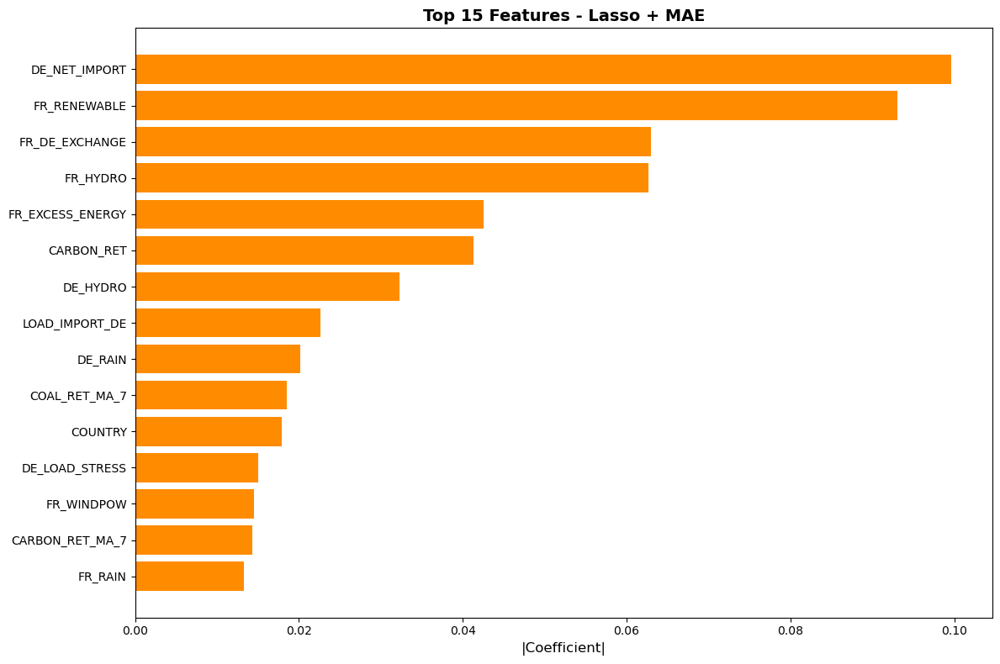

In [235]:
top_15_lasso = non_zero_coefs.head(15).sort_values()
plt.figure(figsize=(12, 8))
plt.barh(range(len(top_15_lasso)), top_15_lasso.values, color='darkorange')
plt.yticks(range(len(top_15_lasso)), top_15_lasso.index)
plt.xlabel('|Coefficient|', fontsize=12)
plt.title('Top 15 Features - Lasso + MAE', fontsize=14, fontweight='bold')

plt.tight_layout()
plt.show()

### 2.3. Modèle - Random Forest Regressor

Les modèles linéaires ne sont pas suffisants pour prédire les variations des prix de l'électricité. Nous allons donc utiliser un modèle non linéaire. Le Random Forest avec MAE est un bon choix de modèle ensembliste car il est robuste au bruit et à la multicolinarité.

In [69]:
def spearman_scorer(y_true, y_pred):
    y_true = np.asarray(y_true).ravel()
    y_pred = np.asarray(y_pred).ravel()
    return spearmanr(y_true, y_pred).correlation

spearman_score = make_scorer(
    spearman_scorer,
    greater_is_better=True
)


param_grid = {
    "n_estimators": [100, 200, 300],        # Plus d'arbres pour plus de stabilité
    "max_depth": [4, 6, 8],                  # Profondeur limitée (pas de None)
    "min_samples_leaf": [20, 50, 100],       # Feuilles plus grandes
    "min_samples_split": [40, 100, 200],     # Split plus conservateur
    "max_features": [0.3, 0.5, "sqrt"]       # Moins de features par arbre
}

rf = RandomForestRegressor(
    criterion="absolute_error",   # MAE
    n_jobs=-1,
    random_state=42,
    bootstrap=True,                # Utiliser bootstrap pour diversité
    max_samples=0.8                # N'utiliser que 80% des données par arbre
)

grid_search = GridSearchCV(
    estimator=rf,
    param_grid=param_grid,
    scoring=spearman_score,
    n_jobs=-1,
    verbose=1
)

grid_search.fit(X_tr, y_tr)
best_rf = grid_search.best_estimator_

y_pred_tr_RF = best_rf.predict(X_tr)
y_val_pred_RF = best_rf.predict(X_val)

spearman_train_RF = spearmanr(y_tr, y_pred_tr_RF).correlation
spearman_val_RF = spearmanr(y_val, y_val_pred_RF).correlation
mae_val_RF = mean_absolute_error(y_val, y_val_pred_RF)

# --- diagnostic overfitting ---
overfitting_gap = spearman_train_RF - spearman_val_RF
print("Modèle Random Forest + MAE")
print("Meilleurs hyperparamètres :", grid_search.best_params_)
print(f"Spearman Train Model: {spearman_train_RF:.4f}")
print(f"Spearman Val Model: {spearman_val_RF:.4f}")
print(f"MAE Val Model: {mae_val_RF:.4f}")

Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Modèle Random Forest + MAE
Meilleurs hyperparamètres : {'max_depth': 6, 'max_features': 0.3, 'min_samples_leaf': 20, 'min_samples_split': 40, 'n_estimators': 100}
Spearman Train Model: 0.5313
Spearman Val Model: 0.2414
MAE Val Model: 0.5496


#### Commentaires:
- Le meilleur modèle sélectionné par le GridSearch arrive à légèrement accroître notre score  de Spearman sur le Validation Set
- On note tout de même que l'écart entre le score de Spearman sur Train et Validation s'est creusé.

Nous nous intéressons à l'importance des features dans le modèle. Nous regardons donc les 15 features ayant les coefficient les plus élevés dans le modèle.

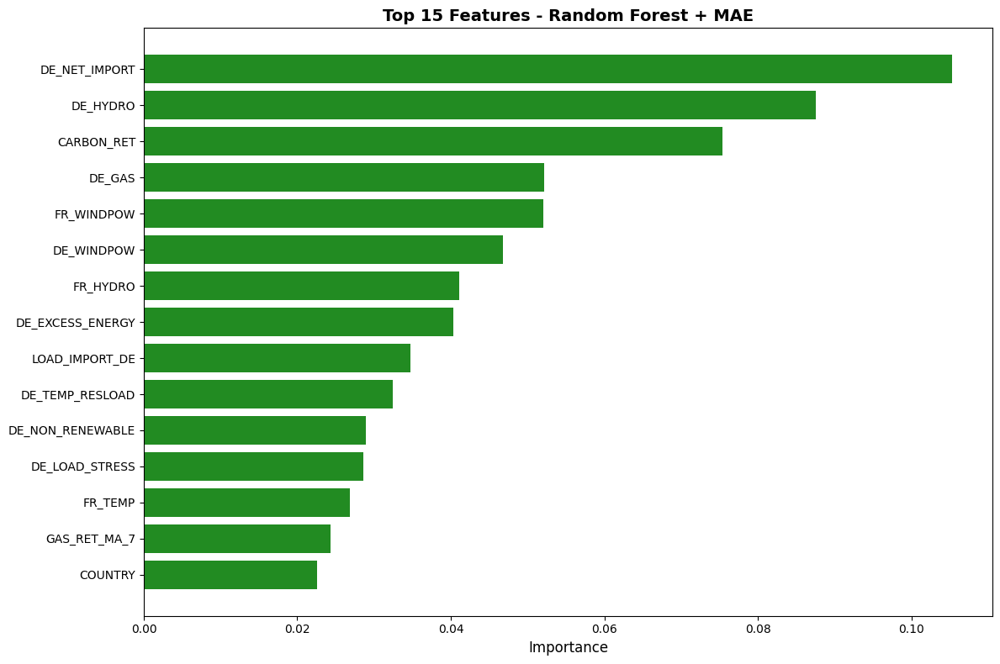

In [538]:
rf_coeffs = pd.Series(best_rf.feature_importances_, index=X_tr.columns)\
               .sort_values(ascending=False)

top_15_rf = rf_coeffs.head(15).sort_values()
plt.figure(figsize=(12, 8))
plt.barh(range(15), top_15_rf.values, color='forestgreen')
plt.yticks(range(15), top_15_rf.index)
plt.xlabel('Importance', fontsize=12)
plt.title('Top 15 Features - Random Forest + MAE', fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

### 2.4. Modèle - LightGBM

In [539]:
param_grid = {
        'num_leaves': [5, 8, 10],
        'max_depth': [2, 3, 4],
        'learning_rate': [0.005, 0.01, 0.03],
        'feature_fraction': [0.4, 0.5],
        'bagging_fraction': [0.5, 0.6],
        'reg_alpha': [0.1, 0.5],
        'min_data_in_leaf': [30, 50, 100]
    }

lgbm = LGBMRegressor(
    objective="regression_l1",   # MAE
    random_state=42,
    n_jobs=-1, # options utiles anti-overfit
    subsample_freq=1    # active le subsampling à chaque itération si subsample < 1
)

grid_search = GridSearchCV(
    estimator=lgbm,
    param_grid=param_grid,
    scoring=spearman_score,
    n_jobs=-1,
    verbose=1
)


grid_search.fit(X_tr, y_tr)
best_lgbm = grid_search.best_estimator_


y_pred_tr_LightGBM = best_lgbm.predict(X_tr)
y_val_pred_LightGBM = best_lgbm.predict(X_val)

spearman_train_LightGBM = spearmanr(y_tr, y_pred_tr_LightGBM).correlation
spearman_val_LightGBM = spearmanr(y_val, y_val_pred_LightGBM).correlation
mae_val_LightGBM = mean_absolute_error(y_val, y_val_pred_LightGBM)

print("Modèle LightGBM + MAE")
print("Meilleurs hyperparamètres :", grid_search.best_params_)
print(f"Spearman Train Model: {spearman_train_LightGBM:.4f}")
print(f"Spearman Val Model: {spearman_val_LightGBM:.4f}")
print(f"MAE Val Model: {mae_val_LightGBM:.4f}")


Fitting 5 folds for each of 648 candidates, totalling 3240 fits
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002201 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 10949
[LightGBM] [I

#### Commentaires:
- Le score obtenu est légèrement plus faible que celui obtenu avec le Random Forest.

### 2.5. Modèle - Neural Network

Pour l'instant les modèles ne parviennt pas à nettement améliorer notre score. Nous allons donc utilisé un réseau de neuronnes. En effet un modèle de deep leraning serait plus adapté à notre dataset.

### 2.6. Comparaison des résultats obtens

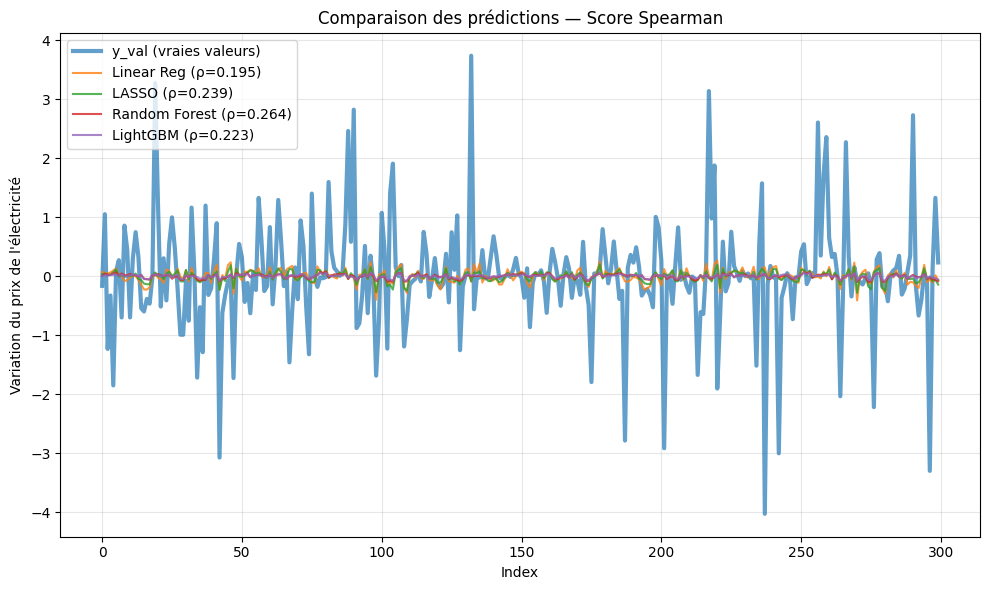

In [541]:

scores = {
    "LR": spearman_val_LR,
    "LASSO": spearman_val_LASSO,
    "RF": spearman_val_RF,
    "LightGBM": spearman_val_LightGBM,
    #"NN" : spearman val_NN
}

# --- plot ---
plt.figure(figsize=(10, 6))

y_val_reset = y_val.reset_index(drop=True)

plt.plot(y_val_reset, label="y_val (vraies valeurs)", linewidth=3, alpha=0.7)
plt.plot(y_val_pred_LR, label=f"Linear Reg (ρ={scores['LR']:.3f})", alpha=0.8)
plt.plot(y_val_pred_LASSO, label=f"LASSO (ρ={scores['LASSO']:.3f})", alpha=0.8)
plt.plot(y_val_pred_RF, label=f"Random Forest (ρ={scores['RF']:.3f})", alpha=0.8)
plt.plot(y_val_pred_LightGBM, label=f"LightGBM (ρ={scores['LightGBM']:.3f})", alpha=0.8)
#plt.plot(y_val_pred_NN, label=f"Neural Network (ρ={scores['NN']:.3f})", alpha=0.8)

plt.xlabel("Index")
plt.ylabel("Variation du prix de l'électricité")
plt.title("Comparaison des prédictions — Score Spearman")
plt.legend(loc='best')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

## 3. Amelioration de la modélisation

Les résultats précédent ne sont pas suffisants, nous allons donc créer un modèle unique pour les variations Allemandes. 

In [262]:
# DE correspond à 0
X_tr_DE = X_tr[X_tr['COUNTRY'] == 0].copy()
y_tr_DE = y_tr.loc[X_tr_DE.index]

X_val_DE = X_val[X_val['COUNTRY'] == 0].copy()
y_val_DE = y_val.loc[X_val_DE.index]

print(f"Allemagne - Train set: {X_tr_DE.shape}, Validation set: {X_val_DE.shape}")

Allemagne - Train set: (513, 32), Validation set: (129, 32)


#### Commentaires:
- Nous pouvons nous permettre de réduire notre datasets avec uniquement les valeurs allemandes car nous avons plus de 500 observations.

### 3.1. Modèle allemand - Lasso

Notre modèle le plus robuste jusqu'à présent était le Lasso, en effet nous prenons en considération plusieurs critères:
- le score de spearman (spearman sur Validation)
- l'écart entre les scores de Spearman sur Train set et Validation set
- la MAE

In [544]:
alphas = np.logspace(-4, 1, 20)

model = QuantileRegressor(
    quantile=0.5,      # MAE
    solver="highs"
)

grid_search = GridSearchCV(
    estimator=model,
    param_grid={"alpha": alphas},
    scoring=spearman_score,
    n_jobs=-1
)

grid_search.fit(X_tr_DE, y_tr_DE)
best_LASSO_DE = grid_search.best_estimator_

y_pred_tr_LASSO_DE = best_LASSO_DE.predict(X_tr_DE)
y_val_pred_LASSO_DE = best_LASSO_DE.predict(X_val_DE)

spearman_train_LASSO_DE = spearmanr(y_tr_DE, y_pred_tr_LASSO_DE).correlation
spearman_val_LASSO_DE = spearmanr(y_val_DE, y_val_pred_LASSO_DE).correlation
mae_val_LASSO_DE = mean_absolute_error(y_val_DE, y_val_pred_LASSO_DE)

print("Modèle Allemand LASSO + MAE ")
print("Meilleur alpha :", grid_search.best_params_["alpha"])
print("Spearman Train Model:", spearman_train_LASSO_DE)
print("Spearman Val Model:", spearman_val_LASSO_DE)
print(f"MAE Val Model: {mae_val_LASSO_DE:.4f}")



Modèle Allemand LASSO + MAE 
Meilleur alpha : 0.0069519279617756054
Spearman Train Model: 0.4418644560484022
Spearman Val Model: 0.3591513864042934
MAE Val Model: 0.5844


/var/folders/nq/qwtx6rd54k7686m_s4y2mxpw0000gn/T/ipykernel_2100/3654817329.py:4: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/nq/qwtx6rd54k7686m_s4y2mxpw0000gn/T/ipykernel_2100/3654817329.py:4: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/nq/qwtx6rd54k7686m_s4y2mxpw0000gn/T/ipykernel_2100/3654817329.py:4: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/nq/qwtx6rd54k7686m_s4y2mxpw0000gn/T/ipykernel_2100/3654817329.py:4: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/nq/qwtx6rd54k7686m_s4y2mxpw0000gn/T/ipykernel_2100/3654817329.py:4: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/nq/qwtx6rd54k7686m_s4y2mxpw0000gn/T/ipykernel_2100/3654817329.py:4: ConstantInputWarning: An input array is cons

#### Commentaires:
- Le score de spearman s'est nettement amélioré, néanmoins l'écart entre les scores de spearman sur Test et Validation est trop élevé. Nous allons donc tenter d'améliorer le modèle pour éviter l'overfitting
- Nous pouvons également tenter de réaliser un Random forest sur ce dataset allemand

### 3.2. Modèle Allemand - Random Forest

In [261]:
param_grid = {
    "n_estimators": [100, 200, 300],        # Plus d'arbres pour plus de stabilité
    "max_depth": [4, 6, 8],                  # Profondeur limitée (pas de None)
    "min_samples_leaf": [20, 50, 100],       # Feuilles plus grandes
    "min_samples_split": [40, 100, 200],     # Split plus conservateur
    "max_features": [0.3, 0.5, "sqrt"]       # Moins de features par arbre
}

rf = RandomForestRegressor(
    criterion="absolute_error",   # MAE
    n_jobs=-1,
    random_state=42,
    bootstrap=True,                # Utiliser bootstrap pour diversité
    max_samples=0.8                # N'utiliser que 80% des données par arbre
)

grid_search = GridSearchCV(
    estimator=rf,
    param_grid=param_grid,
    scoring=spearman_score,
    n_jobs=-1,
    verbose=1
)

grid_search.fit(X_tr_DE, y_tr_DE)
best_rf_DE = grid_search.best_estimator_

y_pred_tr_RF_DE = best_rf_DE.predict(X_tr_DE)
y_val_pred_RF_DE = best_rf_DE.predict(X_val_DE)
spearman_train_RF_DE = spearmanr(y_tr_DE, y_pred_tr_RF_DE).correlation
spearman_val_RF_DE = spearmanr(y_val_DE, y_val_pred_RF_DE).correlation
mae_val_RF_DE = mean_absolute_error(y_val_DE, y_val_pred_RF_DE)


print("Modèle allemand Random Forest + MAE")
print("Meilleurs hyperparamètres :", grid_search.best_params_)
print(f"Spearman Train Model: {spearman_train_RF_DE:.4f}")
print(f"Spearman Val Model: {spearman_val_RF_DE:.4f}")
print(f"MAE Val Model: {mae_val_RF_DE:.4f}")


NameError: name 'X_tr_DE' is not defined

### 3.2. Modèle Allemand - Multi-Layer Perceptron

Lancement de l'Ensemble DE (Optimisé anti-overfitting)...
 Entraînement modèle 1/5...
 Entraînement modèle 2/5...
 Entraînement modèle 3/5...
 Entraînement modèle 4/5...
 Entraînement modèle 5/5...
\ SCORE FINAL ENSEMBLE DE :
Spearman Train : 0.4319
Spearman Test  : 0.3268


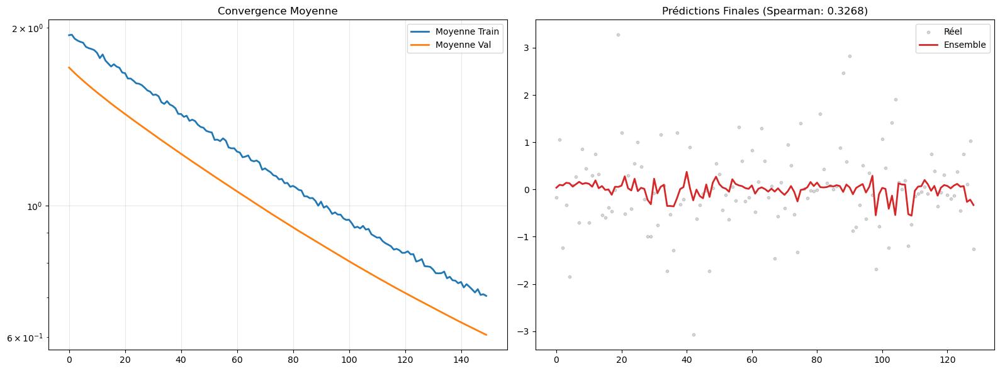

In [277]:
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, models, regularizers, constraints
import matplotlib.pyplot as plt
from scipy.stats import spearmanr
import random
import os

# --- 0. Fixer l'aléatoire pour la reproductibilité ---
def set_reproducibility(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    tf.random.set_seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    os.environ['TF_DETERMINISTIC_OPS'] = '1'

set_reproducibility(42)

# --- 1. Architecture du Modèle ---
def build_ultra_reg_model(input_shape):
    model = models.Sequential([
        layers.Input(shape=(input_shape,)), 
        
        # GaussianNoise (0.05) : Ajoute du bruit aux entrées pour forcer le modèle 
        # à apprendre des tendances générales plutôt que des points de données précis.
        layers.GaussianNoise(0.07),
        
        # Couche 1 : Dense(16) avec L2(0.01) : Contraint fortement les poids 
        # pour éviter la mémorisation du bruit (Complexité réduite).
        layers.Dense(16, kernel_regularizer=regularizers.l2(0.04), 
                     kernel_constraint=constraints.MaxNorm(3)), 
        layers.BatchNormalization(),
        layers.LeakyReLU(negative_slope=0.1), 
        
        # Dropout (0.4) : Désactive aléatoirement 40% des neurones pour éviter 
        # la co-dépendance et forcer la robustesse.
        layers.Dropout(0.5), 
        
        # Couche 2 : Dense(8) : Compression finale de l'information.
        layers.Dense(8, kernel_regularizer=regularizers.l2(0.04)),
        layers.BatchNormalization(),
        layers.LeakyReLU(negative_slope=0.1), 
        layers.Dropout(0.4),
        
        layers.Dense(1) 
    ])
    
    # Clipnorm=1.0 : Empêche l'explosion des gradients pour stabiliser l'ensemble.
    optimizer = tf.keras.optimizers.Adam(learning_rate=0.0003, clipnorm=1.0)
    model.compile(optimizer=optimizer, loss='huber')
    return model

# --- 2. Entraînement de l'Ensemble ---
n_members = 5  
all_test_preds = []
all_train_preds = []
all_histories = []

print(f"Lancement de l'Ensemble DE (Optimisé anti-overfitting)...")

for i in range(n_members):
    print(f" Entraînement modèle {i+1}/{n_members}...")
    # Seed différente pour chaque membre pour diversifier les erreurs de l'ensemble
    set_reproducibility(seed=i+100) 
    
    model = build_ultra_reg_model(X_tr_DE.shape[1])
    
    # Réduction du LR si stagnation
    reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6)
    
    # EarlyStopping strict (patience=10) pour couper avant que le Train ne plonge seul.
    early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
    
    history = model.fit(
        X_tr_DE, y_tr_DE, 
        validation_data=(X_val_DE, y_val_DE),
        epochs=150, 
        batch_size=128, # Batch size large pour stabiliser le gradient
        verbose=0, 
        callbacks=[early_stop, reduce_lr]
    )
    
    all_histories.append(history.history)
    all_train_preds.append(model.predict(X_tr_DE, verbose=0))
    all_test_preds.append(model.predict(X_val_DE, verbose=0))

# --- 3. Agrégation et Calcul des Scores ---
y_tr_pred_final = np.mean(all_train_preds, axis=0).flatten()
y_te_pred_final = np.mean(all_test_preds, axis=0).flatten()

# Calcul du Spearman (Corrélation de rang)
rho_train, _ = spearmanr(y_tr_DE, y_tr_pred_final)
rho_test, _ = spearmanr(y_val_DE, y_te_pred_final)

print(f"\ SCORE FINAL ENSEMBLE DE :")
print(f"Spearman Train : {rho_train:.4f}")
print(f"Spearman Test  : {rho_test:.4f}")

# --- 4. Visualisation ---
plt.figure(figsize=(16, 6))

# Graphe de Convergence (Loss)
plt.subplot(1, 2, 1)
max_len = max([len(h['loss']) for h in all_histories])
def pad(data, length): return np.array([d + [d[-1]]*(length-len(d)) for d in data])
avg_train = np.mean(pad([h['loss'] for h in all_histories], max_len), axis=0)
avg_val = np.mean(pad([h['val_loss'] for h in all_histories], max_len), axis=0)

plt.plot(avg_train, color='#1f77b4', lw=2, label='Moyenne Train')
plt.plot(avg_val, color='#ff7f0e', lw=2, label='Moyenne Val')
plt.yscale('log')
plt.title('Convergence Moyenne')
plt.legend()
plt.grid(True, alpha=0.3)

# Graphe de Prédictions
plt.subplot(1, 2, 2)
zoom_size = min(200, len(y_val_DE))
plt.scatter(range(zoom_size), y_val_DE.values[:zoom_size] if hasattr(y_val_DE, 'values') else y_val_DE[:zoom_size], 
            color='black', alpha=0.15, s=10, label='Réel')
plt.plot(range(zoom_size), y_te_pred_final[:zoom_size], color='#d62728', lw=2, label='Ensemble')
plt.title(f'Prédictions Finales (Spearman: {rho_test:.4f})')
plt.legend()

plt.tight_layout()
plt.show()

### Commentaires : 
- Le modèle semble plus robuste que le Lasso sur le dataset allemand, avec moins d'overfitting.

### 3.3. Sélection de features - Elbow

Nous allon tenter d'améliorer le modèle Lasso appliqué aux variations allemandes. Pour cela, nous allons sélectionner les features "les plus explicatifs" en appliquant la méthode du coude (Elbow method).

/Users/lola/Documents/GitHub/Statistical-Learning/venv/lib/python3.13/site-packages/pandas/core/nanops.py:1632: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  return spearmanr(a, b)[0]


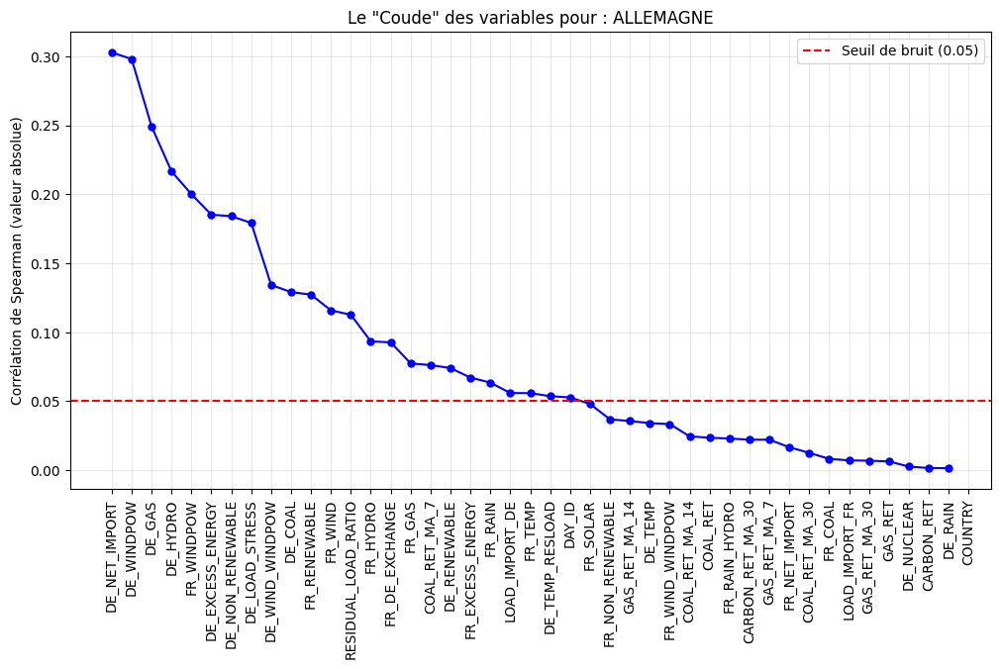

In [550]:
def plot_spearman_elbow(X, y, country_name):
    # Calcul de la corrélation de Spearman pour chaque variable
    correlations = {}
    for col in X.columns:
        corr = X[col].corr(y, method='spearman')
        correlations[col] = abs(corr)
    
    # tri par ordre croissant
    sorted_corr = pd.Series(correlations).sort_values(ascending=False)
    

    plt.figure(figsize=(12, 6))
    plt.plot(range(len(sorted_corr)), sorted_corr.values, 'bo-', markersize=5)
    plt.xticks(range(len(sorted_corr)), sorted_corr.index, rotation=90)
    plt.ylabel('Corrélation de Spearman (valeur absolue)')
    plt.title(f'Le "Coude" des variables pour : {country_name}')
    plt.grid(True, alpha=0.3)
    
    plt.axhline(y=0.05, color='r', linestyle='--', label='Seuil de bruit (0.05)')
    plt.legend()
    plt.show()

plot_spearman_elbow(X_tr_DE, y_tr_DE, "ALLEMAGNE")

In [552]:
cols_to_keep_DE = [
    "DE_NET_IMPORT",
    "DE_WINDPOW",
    "DE_GAS",
    "DE_HYDRO",
    "FR_WINDPOW",
    "DE_EXCESS_ENERGY",
    "DE_NON_RENEWABLE",
    "DE_LOAD_STRESS",
    "DE_WIND_WINDPOW"
]

X_tr_DE_elbow = X_tr_DE[cols_to_keep_DE].copy()
X_val_DE_elbow= X_val_DE[cols_to_keep_DE].copy()


### 3.4. Modèle allemand final - Lasso

Nous réalisons à nouveau un modèle Lasso sur notre nouveau dataset allemand.

In [556]:
alphas = np.logspace(-4, 1, 20)

model = QuantileRegressor(
    quantile=0.5,      # MAE
    solver="highs"
)

grid_search = GridSearchCV(
    estimator=model,
    param_grid={"alpha": alphas},
    scoring=spearman_score,
    n_jobs=-1
)

grid_search.fit(X_tr_DE_elbow, y_tr_DE)
best_LASSO_DE_elbow = grid_search.best_estimator_

y_pred_tr_LASSO_DE_elbow= best_LASSO_DE_elbow.predict(X_tr_DE_elbow)
y_val_pred_LASSO_DE_elbow = best_LASSO_DE_elbow.predict(X_val_DE_elbow)

spearman_train_LASSO_DE_elbow = spearmanr(y_tr_DE, y_pred_tr_LASSO_DE_elbow).correlation
spearman_val_LASSO_DE_elbow = spearmanr(y_val_DE, y_val_pred_LASSO_DE_elbow).correlation
mae_val_LASSO_DE_elbow = mean_absolute_error(y_val_DE, y_val_pred_LASSO_DE_elbow)

print("Modèle final Allemand LASSO + MAE ")
print("Meilleur alpha :", grid_search.best_params_["alpha"])
print("Spearman Train Model:", spearman_train_LASSO_DE_elbow)
print("Spearman Val Model:", spearman_val_LASSO_DE_elbow)
print(f"MAE Val Model: {mae_val_LASSO_DE_elbow:.4f}")




Modèle final Allemand LASSO + MAE 
Meilleur alpha : 0.0006158482110660267
Spearman Train Model: 0.3975566241469274
Spearman Val Model: 0.35711091234347053
MAE Val Model: 0.5758


/var/folders/nq/qwtx6rd54k7686m_s4y2mxpw0000gn/T/ipykernel_2100/3654817329.py:4: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/nq/qwtx6rd54k7686m_s4y2mxpw0000gn/T/ipykernel_2100/3654817329.py:4: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/nq/qwtx6rd54k7686m_s4y2mxpw0000gn/T/ipykernel_2100/3654817329.py:4: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/nq/qwtx6rd54k7686m_s4y2mxpw0000gn/T/ipykernel_2100/3654817329.py:4: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/nq/qwtx6rd54k7686m_s4y2mxpw0000gn/T/ipykernel_2100/3654817329.py:4: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/var/folders/nq/qwtx6rd54k7686m_s4y2mxpw0000gn/T/ipykernel_2100/3654817329.py:4: ConstantInputWarning: An input array is cons